### Problem Statement:
Every year a lot of companies hire a number of employees. The companies invest time and money in training those employees, not just this but there are training programs within the companies for their existing employees as well. The aim of these programs is to increase the effectiveness of their employees. But where HR Analytics fit in this? and is it just about improving the performance of employees?

HR Analytics

Human resource analytics (HR analytics) is an area in the field of analytics that refers to applying analytic processes to the human resource department of an organization in the hope of improving employee performance and therefore getting a better return on investment. HR analytics does not just deal with gathering data on employee efficiency. Instead, it aims to provide insight into each process by gathering data and then using it to make relevant decisions about how to improve these processes.

Attrition in HR

Attrition in human resources refers to the gradual loss of employees overtime. In general, relatively high attrition is problematic for companies. HR professionals often assume a leadership role in designing company compensation programs, work culture, and motivation systems that help the organization retain top employees.

How does Attrition affect companies? and how does HR Analytics help in analyzing attrition? We will discuss the first question here and for the second question, we will write the code and try to understand the process step by step.

Attrition affecting Companies

A major problem in high employee attrition is its cost to an organization. Job postings, hiring processes, paperwork, and new hire training are some of the common expenses of losing employees and replacing them. Additionally, regular employee turnover prohibits your organization from increasing its collective knowledge base and experience over time. This is especially concerning if your business is customer-facing, as customers often prefer to interact with familiar people. Errors and issues are more likely if you constantly have new workers

### Importing Necessary Libraries

In [310]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

### Loading the Dataset

In [311]:
df = pd.read_csv('WA_Fn-UseC_-HR-Employee-Attrition.csv')
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


### Getting statistical information of dataset

In [312]:
df.shape

(1470, 35)

- we have 1470 rows and 35 columns

In [313]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

### Checking categeorical variables

In [314]:
#checking for categeorical columns
features_list = []
for feature_type in df.dtypes.index:
    if df.dtypes[feature_type]=='object':
        features_list.append(feature_type)
features_list

['Attrition',
 'BusinessTravel',
 'Department',
 'EducationField',
 'Gender',
 'JobRole',
 'MaritalStatus',
 'Over18',
 'OverTime']

- These all are teh categorical variables present in df

In [315]:
# Lets find the unique values which are present in categeorical columns
for feature in features_list:
    print(feature)
    print(df[feature].value_counts())
    print('--------------------------------------')

Attrition
No     1233
Yes     237
Name: Attrition, dtype: int64
--------------------------------------
BusinessTravel
Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: BusinessTravel, dtype: int64
--------------------------------------
Department
Research & Development    961
Sales                     446
Human Resources            63
Name: Department, dtype: int64
--------------------------------------
EducationField
Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: EducationField, dtype: int64
--------------------------------------
Gender
Male      882
Female    588
Name: Gender, dtype: int64
--------------------------------------
JobRole
Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representativ

- Attrition i sthe output dependent variable(output) and has 2 values (yes,no)
- BussinessTravel feature have 3 categorical variables(Travel_Rarely,Travel_Frequently,Non-Travel)
- Department feature has 3 categeorical variables (Research & Development,Sales,Human Resources)
- EducationField has 6 categeorical variables (Life Sciences,Medical,Marketing,Technical Degree,Other,Human Resources)
- Gender has 2 categeorical variables (Male,Female)
- JobRole has 9 categeorical variables (Sales Executive,Research Scientist,Laboratory Technician,Manufacturing Director,Healthcare Representative,Manager,Sales Representative,Research Director,Human Resources)
- Maritial Status has 3 categorical variables(Married,Single,Divorced)
- over18 has only one column (Y)
- Overtime has 2 categorical variables(Yes,No)


In [316]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [317]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

### lets find the unique values in the numerical data

In [318]:
#checking for numerical columns
features_num_list = []
for feature_type in df.dtypes.index:
    if df.dtypes[feature_type]=='int64':
        features_num_list.append(feature_type)
features_num_list

['Age',
 'DailyRate',
 'DistanceFromHome',
 'Education',
 'EmployeeCount',
 'EmployeeNumber',
 'EnvironmentSatisfaction',
 'HourlyRate',
 'JobInvolvement',
 'JobLevel',
 'JobSatisfaction',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'PercentSalaryHike',
 'PerformanceRating',
 'RelationshipSatisfaction',
 'StandardHours',
 'StockOptionLevel',
 'TotalWorkingYears',
 'TrainingTimesLastYear',
 'WorkLifeBalance',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager']

In [319]:
# Lets find the unique values which are present in numerical columns
for feature in features_num_list:
    print(feature)
    dta = df[feature].unique()
    print(dta)
    print('The length is : ',len(dta))
    print('--------------------------------------')

Age
[41 49 37 33 27 32 59 30 38 36 35 29 31 34 28 22 53 24 21 42 44 46 39 43
 50 26 48 55 45 56 23 51 40 54 58 20 25 19 57 52 47 18 60]
The length is :  43
--------------------------------------
DailyRate
[1102  279 1373 1392  591 1005 1324 1358  216 1299  809  153  670 1346
  103 1389  334 1123 1219  371  673 1218  419  391  699 1282 1125  691
  477  705  924 1459  125  895  813 1273  869  890  852 1141  464 1240
 1357  994  721 1360 1065  408 1211 1229  626 1434 1488 1097 1443  515
  853 1142  655 1115  427  653  989 1435 1223  836 1195 1339  664  318
 1225 1328 1082  548  132  746  776  193  397  945 1214  111  573 1153
 1400  541  432  288  669  530  632 1334  638 1093 1217 1353  120  682
  489  807  827  871  665 1040 1420  240 1280  534 1456  658  142 1127
 1031 1189 1354 1467  922  394 1312  750  441  684  249  841  147  528
  594  470  957  542  802 1355 1150 1329  959 1033 1316  364  438  689
  201 1427  857  933 1181 1395  662 1436  194  967 1496 1169 1145  630
  303 1256  44

In [320]:
# As the employee Number, Employee count, StandaradHours columns is least useful to develop the model hence dropping it
df.drop(columns=['EmployeeNumber', 'StandardHours','EmployeeCount','Over18'],inplace=True, axis=1)
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,2,Female,...,3,1,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,3,Male,...,4,4,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,4,Male,...,3,2,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,4,Female,...,3,3,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,Male,...,3,4,1,6,3,3,2,2,2,2


In [321]:
df.isna().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSinceLastPromotion     0
YearsWithCurrManager        0
dtype: int64

<AxesSubplot:>

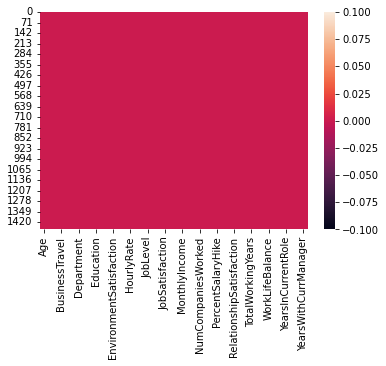

In [322]:
sns.heatmap(df.isna())

- There are no null values present in the dataset

### Visulalization

#### Univariate Analaysis

<AxesSubplot:xlabel='BusinessTravel', ylabel='count'>

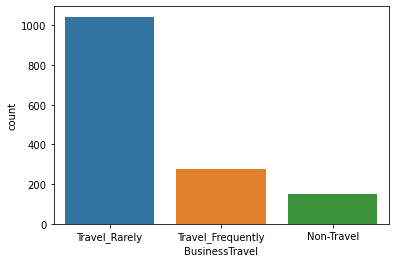

In [323]:
sns.countplot(df['BusinessTravel'])

- From the above graph we can say most of the employees travel very rarely
- 200 employess travel frequently for business travels
- There are also employess who doesn't travel

<AxesSubplot:xlabel='Department', ylabel='count'>

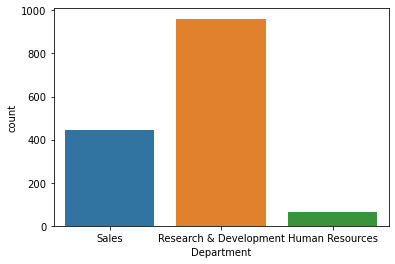

In [324]:
sns.countplot(df['Department'])

- In the total dataset there are many people related to the research and development department followed by sales
- There are very less people in human resources

([<matplotlib.patches.Wedge at 0x7f7ba9169e80>,
 [Text(0.2994329091618902, 1.0584611154458379, 'Life Sciences'),
  Text(-0.9951095091219136, -0.4687825347164123, 'Medical'),
  Text(0.2194966396897843, -1.0778781123878958, 'Marketing'),
  Text(0.806357022319634, -0.7481900510938471, 'Technical Degree'),
  Text(1.05386333339301, -0.315233365191208, 'Other'),
  Text(1.09816922292375, -0.06343782643697084, 'Human Resources')],
 [Text(0.16332704136103102, 0.5773424266068207, '41.22%'),
  Text(-0.5427870049755892, -0.2556995643907703, '31.56%'),
  Text(0.11972543983079142, -0.5879335158479431, '10.82%'),
  Text(0.4398311030834367, -0.4081036642330074, '8.98%'),
  Text(0.5748345454870963, -0.17194547192247708, '5.58%'),
  Text(0.5990013943220454, -0.03460245078380227, '1.84%')])

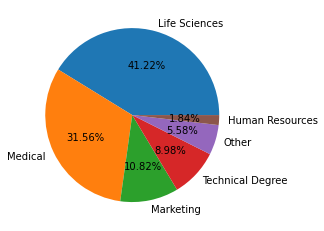

In [325]:
labels = ['Life Sciences','Medical','Marketing','Technical Degree','Other','Human Resources']
plt.pie(df['EducationField'].value_counts(),autopct='%1.2f%%',labels=labels)

- In the office most of the people belong to the background Life Sciences followed by Medical,Marketing,Technical Degree,Other,Human Resources

<AxesSubplot:xlabel='Gender', ylabel='count'>

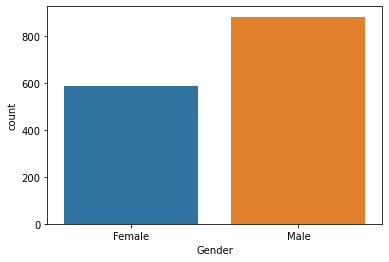

In [326]:
sns.countplot(df['Gender'])

- Most of the working professionals are Male candiadtes in this data

<AxesSubplot:xlabel='JobRole', ylabel='count'>

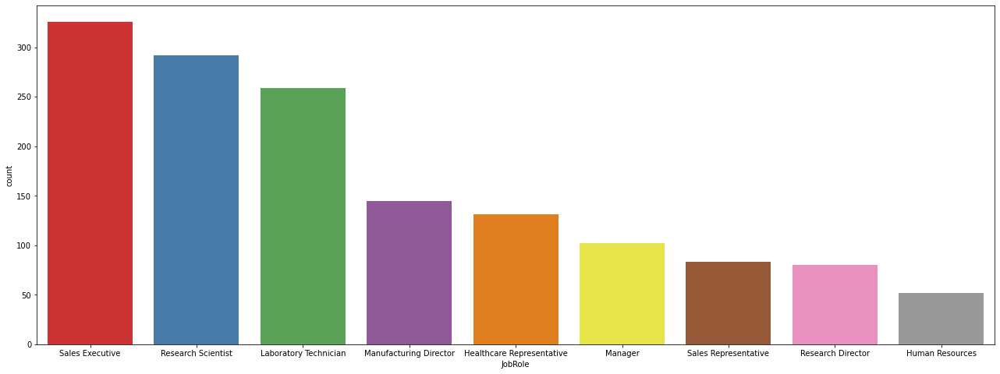

In [327]:
plt.figure(figsize=(22,8))
sns.countplot(df['JobRole'],palette='Set1')

- Most of employees are with Jobrole Sales Executive followed by Research Scientist,Laborartory Technician,Manufacturing Director,Health Care Representativemmanager,sales representative,research director,human resources

([<matplotlib.patches.Wedge at 0x7f7bed738c70>,
 [Text(0.14532668706692153, 1.090357810090868, 'Married'),
  Text(-0.8127234517318653, -0.7412695805205031, 'Single'),
  Text(0.8421449847682699, -0.7076664642539242, 'Divorced')],
 [Text(0.07926910203650266, 0.594740623685928, '45.78%'),
  Text(-0.4433037009446538, -0.4043288621020925, '31.97%'),
  Text(0.45935180987360175, -0.38599988959304954, '22.24%')])

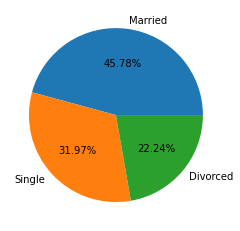

In [328]:
labels = ['Married','Single','Divorced']
plt.pie(df['MaritalStatus'].value_counts(),autopct='%1.2f%%',labels=labels)

- Married employees are 45.78%
- Single employess are 31.97%
- Divorced Employess are 22.24%

<AxesSubplot:xlabel='OverTime', ylabel='count'>

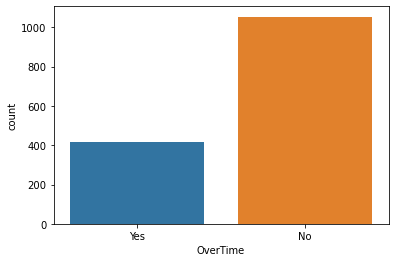

In [329]:
sns.countplot(df['OverTime'])

([<matplotlib.patches.Wedge at 0x7f7bc81f0370>,
 [Text(-0.6931655117563702, 0.8541203506014416, 'No'),
  Text(0.6931655117563698, -0.8541203506014421, 'Yes')],
 [Text(-0.3780902791398382, 0.4658838276007863, '71.70%'),
  Text(0.378090279139838, -0.46588382760078656, '28.30%')])

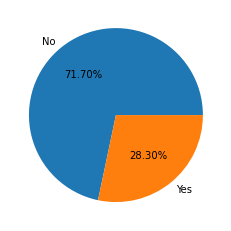

In [330]:
labels = ['No','Yes']
plt.pie(df['OverTime'].value_counts(),autopct='%1.2f%%',labels=labels)

- 71.70% of the employees doesn't work overtime

### Bi-Variate Analaysis

<AxesSubplot:xlabel='Department', ylabel='count'>

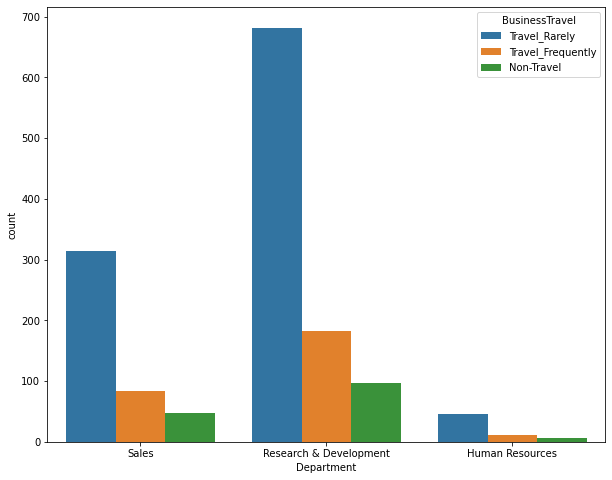

In [331]:
plt.figure(figsize=(10,8))
sns.countplot(x='Department', hue='BusinessTravel', data=df)

- Most of the employess of Research and development Department travel rarely.
- Most of the employees of Research and development Department travel frequently.
- From the above the the upper hand is for Research and development department.

<AxesSubplot:xlabel='MaritalStatus', ylabel='count'>

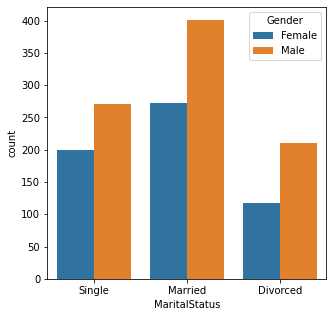

In [332]:
plt.figure(figsize=(5,5))
sns.countplot(x='MaritalStatus', hue='Gender', data=df)

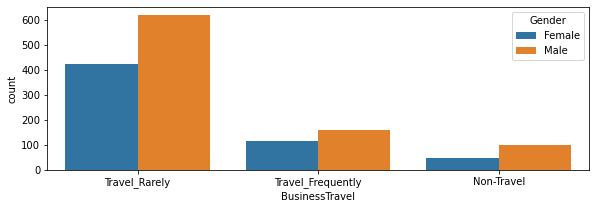

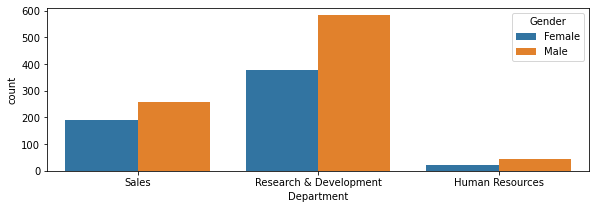

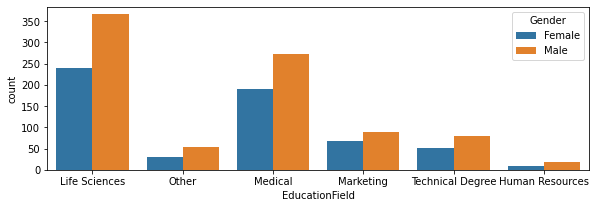

In [333]:
ftrs = ['BusinessTravel','Department','EducationField']
pltnum=1
for feature in ftrs:
    plt.figure(figsize=(33,3))
    plt.subplot(1,3,pltnum)
    sns.countplot(x=df[feature], hue='Gender', data=df)
    pltnum+=1
plt.show()
    

- Male Employess from every department are high in number for traveeling rarerly/frequently/Non-travel
- male Candidates are more in Research&Development,Sales,Human Resources dpts
- In every EducationField Male candidates are more 

#### Bivariate analaysis for categeorical variables and attrtion rate

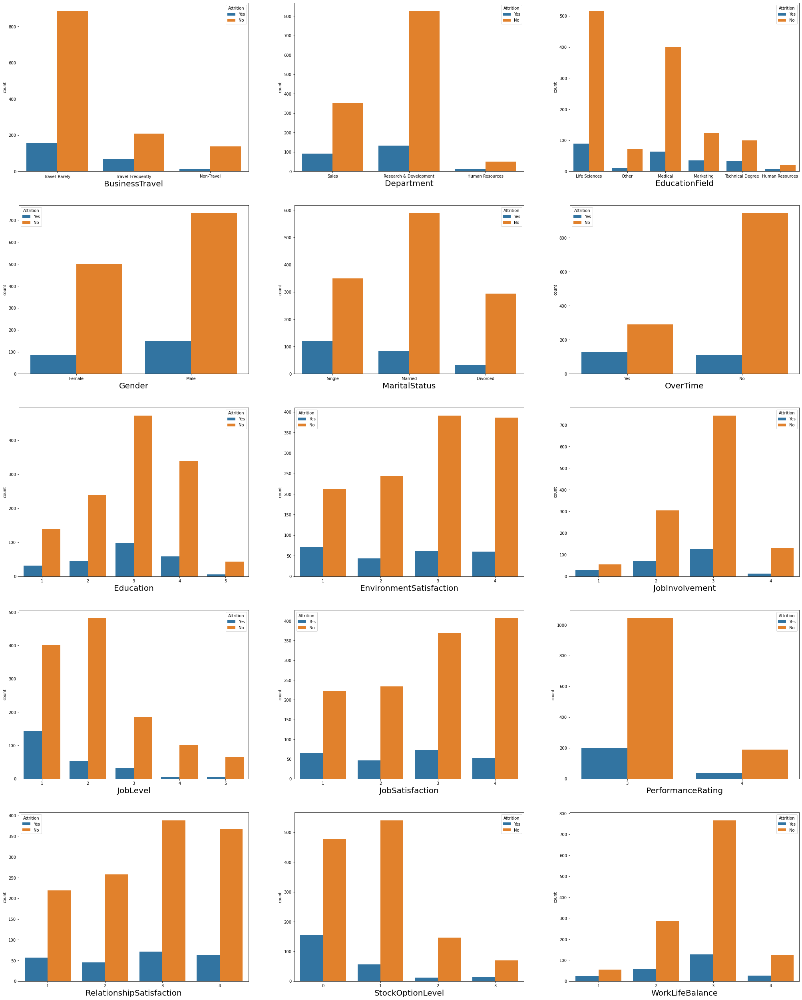

In [334]:
plt.figure(figsize=(35,45),facecolor='white')
cat_ftrs = ['BusinessTravel','Department','EducationField','Gender','MaritalStatus','OverTime','Education','EnvironmentSatisfaction','JobInvolvement','JobLevel','JobSatisfaction','PerformanceRating','RelationshipSatisfaction','StockOptionLevel','WorkLifeBalance']
pltnum=1
for feature in cat_ftrs:
    plt.subplot(5,3,pltnum)
    sns.countplot(x=df[feature], hue='Attrition', data=df)
    plt.xlabel(feature,fontsize=20)
    pltnum+=1
plt.show()

<AxesSubplot:xlabel='JobRole', ylabel='count'>

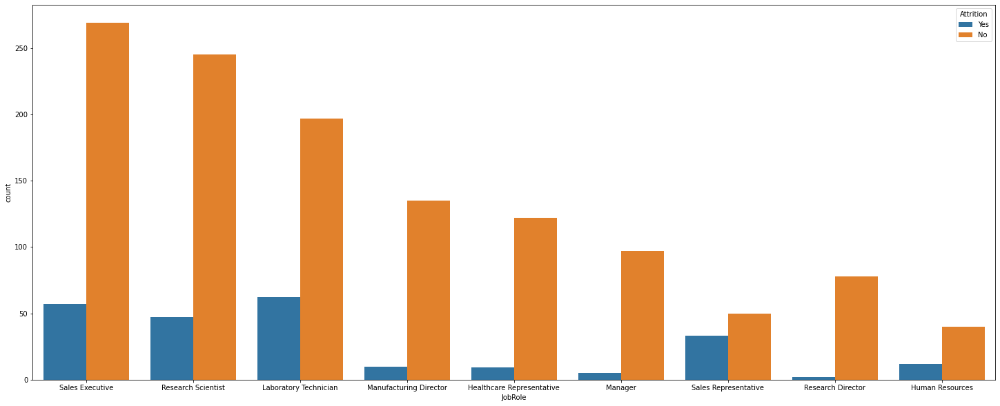

In [335]:
plt.figure(figsize=(25,10),facecolor='white')
sns.countplot(x=df['JobRole'],hue=df['Attrition'])

From the above Graphs
- Attrition Rate is less for the Employees who rarely Travel
- Attrition Rate is less for the Employees from Department research & Development and very less in Human Resource
- Attrition is less in Lifesciences,medical followed by marketing and very less in Human Resource
- In Gender Male categeory has less attrition compared to female
- Employees whose martial Status is Married are highly retailed.
- Employees who are not working Overtime are highly Retained.
- The employees who has their education level as 3 and 4 are highly retained while level 1 contributed more for attrition.
- Employees who has 3,4 level environment satisfaction has retained the most.
- Employees with Job-involvment 3 are retained the most.
- Joblevel 2,3 are retained the most.
- Employees with highest job satisfaction have retained the most
- Employees with performance rating 3 are retained most compared to 4 rating
- Employees with Relationship satisfaction 3 are retained most
- Employees with StockOption level 1 are retained the most. While Employees with stock optoion level 0 contribute most to Attrition.
- Employees who has level-3 worklife balance are retained most compared to level-4
- Employees whose job role ia sales executive has less attrition rate.

#### Bivariate Analaysis for attrition rate and numerical columns

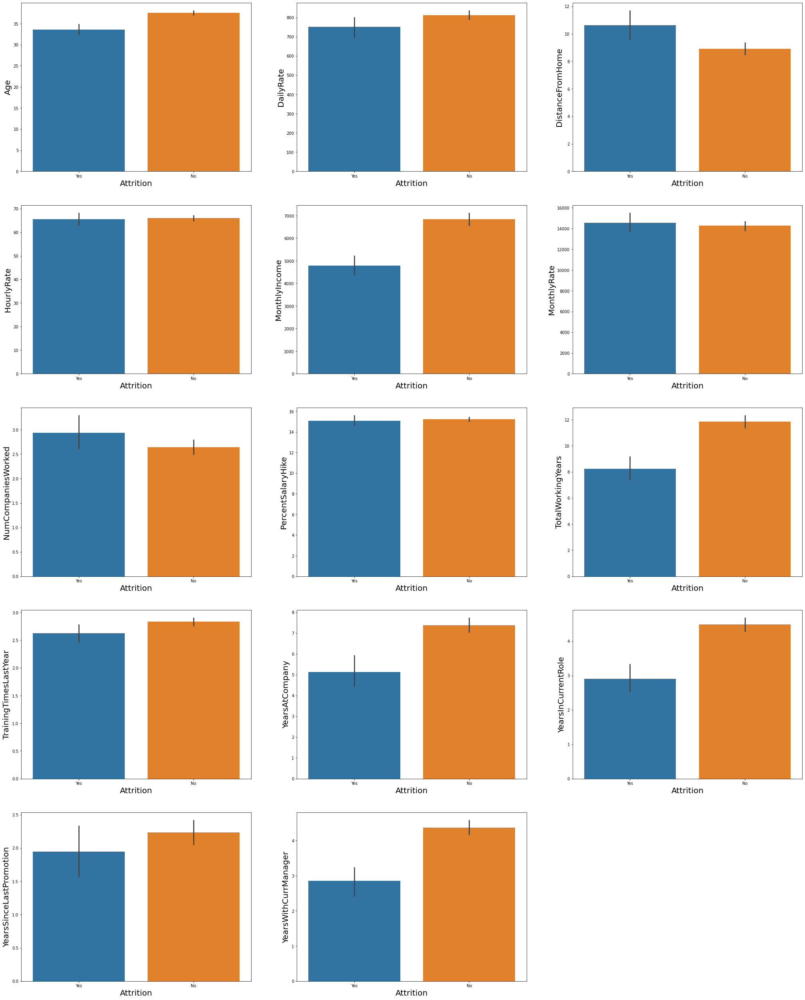

In [336]:
plt.figure(figsize=(35,45),facecolor='white')
cat_ftrs = ['Age','DailyRate','DistanceFromHome','HourlyRate','MonthlyIncome','MonthlyRate','NumCompaniesWorked','PercentSalaryHike','TotalWorkingYears','TrainingTimesLastYear','YearsAtCompany','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']
pltnum=1
for feature in cat_ftrs:
    plt.subplot(5,3,pltnum)
    sns.barplot(df['Attrition'],df[feature])
    plt.xlabel('Attrition',fontsize=20)
    plt.ylabel(feature,fontsize=20)
    pltnum+=1
plt.show()

From the above graph the Observations are
- The attrition level is more for the people who has less attrition rate.
- DailyRate doesnt have much difference in attrition rate
- Employees who distance from home is more than 10 are having high attrition rate
- Hourly rate doesnt have any difference in attrition and retention
- Employees whose monthly income is more than 6000 has retained compared to 4800 and below
- Monthly Rate doesnt show much difference
- Employees with lowest salary hike are contributing more for attrition.
- Employees who has less than 8 working years contributed more for attrition.
- Employees who are less than 8 years in the company contributed more for attrition.
- Employees who are less than 2.8 years in current role contributed more for attrition.
- Employees who doesnt get promotion from paste 1.5 Years are contributed more for attrition.
- Employees for less than 2.8 years with current manager contributed more for attrition

### Checking for outliers

In [337]:
x = df.drop('Attrition',axis=1)
y = df['Attrition']

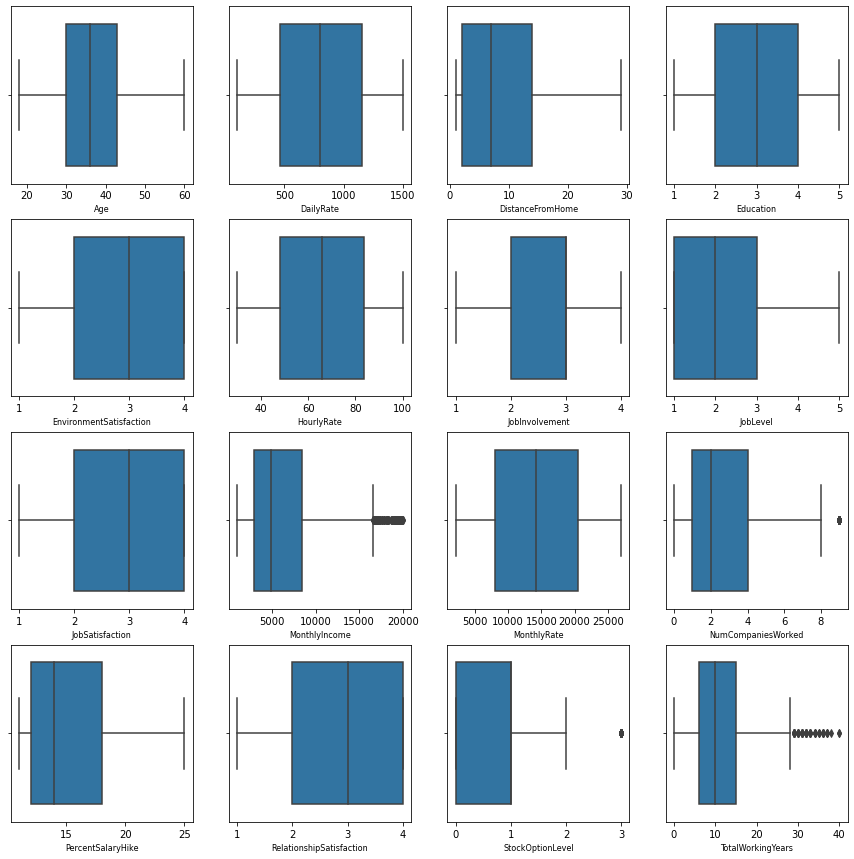

In [338]:
plt.figure(figsize=(15,15),facecolor='white')
plotnum=1
for col in x.drop(columns = ['BusinessTravel','Department','PerformanceRating','EducationField','Gender','JobRole','MaritalStatus','OverTime']):
    if plotnum<=16:
        plt.subplot(4,4,plotnum)
        sns.boxplot(x[col])
        plt.xlabel(col,fontsize=8)
    plotnum+=1
plt.show()

- Outliers are present in Monthlyincome,NumCompaniesWorked,StockOptionLevel,TotalWorkingYears

### Removing outliers using Z-score Method


In [339]:
#new_df with no cat variables
new_num_df = x.drop(columns=['BusinessTravel','Department','PerformanceRating','EducationField','Gender','JobRole','MaritalStatus','OverTime']).copy()
new_num_df.head()

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,...,PercentSalaryHike,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,2,94,3,2,4,5993,...,11,1,0,8,0,1,6,4,0,5
1,49,279,8,1,3,61,2,2,2,5130,...,23,4,1,10,3,3,10,7,1,7
2,37,1373,2,2,4,92,2,1,3,2090,...,15,2,0,7,3,3,0,0,0,0
3,33,1392,3,4,4,56,3,1,3,2909,...,11,3,0,8,3,3,8,7,3,0
4,27,591,2,1,1,40,3,1,2,3468,...,12,4,1,6,3,3,2,2,2,2


In [340]:

# Applying Z-score Method
from scipy.stats import zscore
zscore_abs = np.abs(zscore(new_num_df))
#Threshold is taken as +3/-3
zdf = new_num_df[(zscore_abs < 3).all(axis=1)]

In [341]:
x.shape

(1470, 30)

In [342]:
zdf.shape

(1387, 22)

In [343]:
print('The Loss is ',(1470-1387)/1470*100)

The Loss is  5.646258503401361


- Loss is under 5.64 and is under acceptable range

### Using IQR METHOD

In [344]:
outlier_index= np.array([])
for column in new_num_df:
    q1 = new_num_df[column].quantile(0.25)
    q3 = new_num_df[column].quantile(0.75)
    IQR= q3-q1
    col = new_num_df[column]
    indx = col[(col > q3+1.5*IQR) | (col < q1-1.5*IQR)].index
    outlier_index = np.append(outlier_index,indx)
outlier_index

array([  25.,   29.,   45.,   62.,  105.,  106.,  112.,  119.,  123.,
        147.,  165.,  186.,  187.,  190.,  194.,  231.,  233.,  237.,
        244.,  257.,  263.,  270.,  279.,  280.,  290.,  314.,  326.,
        329.,  379.,  392.,  400.,  411.,  417.,  425.,  429.,  445.,
        466.,  473.,  477.,  489.,  497.,  535.,  538.,  561.,  568.,
        584.,  588.,  592.,  595.,  609.,  653.,  699.,  710.,  714.,
        716.,  741.,  746.,  749.,  755.,  766.,  770.,  774.,  799.,
        804.,  810.,  814.,  851.,  858.,  861.,  867.,  869.,  894.,
        898.,  899.,  904.,  907.,  913.,  916.,  918.,  922.,  936.,
        937.,  945.,  954.,  955.,  956.,  999., 1008., 1009., 1024.,
       1043., 1055., 1080., 1116., 1126., 1129., 1135., 1140., 1154.,
       1184., 1185., 1225., 1242., 1264., 1277., 1330., 1331., 1348.,
       1351., 1374., 1377., 1401., 1437., 1443.,    4.,   38.,   50.,
         95.,  105.,  122.,  194.,  198.,  208.,  245.,  287.,  290.,
        334.,  371.,

In [345]:
print(new_num_df.shape)
new_df = new_num_df.drop(outlier_index)
print(new_df.shape)

(1470, 22)
(925, 22)


In [346]:
print('The loss with IQR method is',(1470-925)/1470*100)

The loss with IQR method is 37.07482993197279


- Loss 37.07 is huge and is not in acceptable range 

#### getting the values of zdf to original df

In [347]:
drop_outliers_from_df = df.index.difference(zdf.index)
df.drop(drop_outliers_from_df,inplace=True)
df.reset_index(drop=True, inplace=True)

In [348]:
df.shape

(1387, 31)

#### Lets See Correlation Again

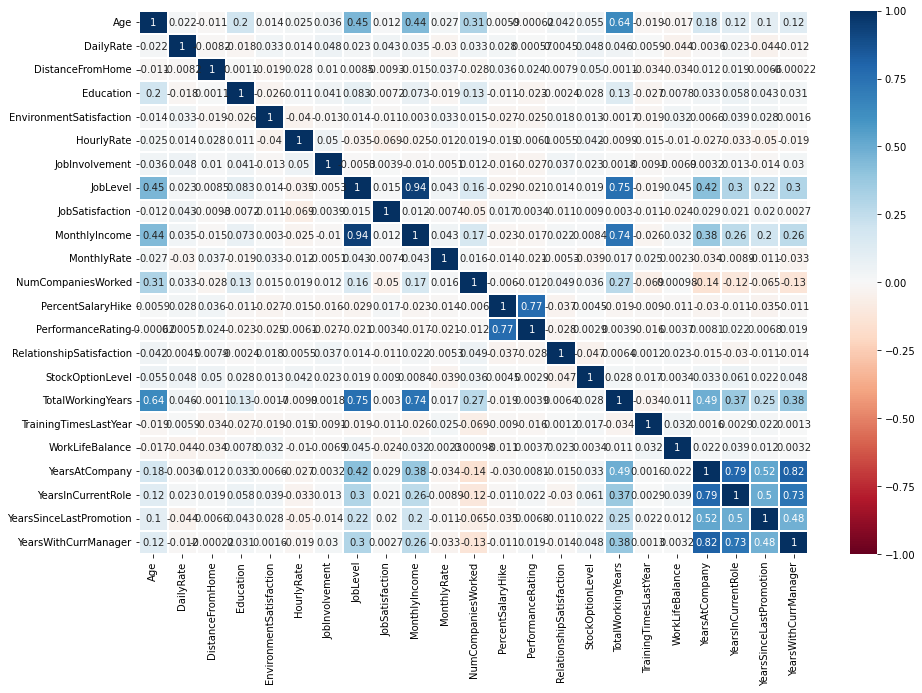

In [349]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr(),annot=True,cmap='RdBu',vmin=-1,vmax=+1,linewidths=2)
plt.show()

### Label Encoding the categeorical values

In [350]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
cat_col = ['Attrition','BusinessTravel','Department','EducationField','Gender','JobRole','MaritalStatus','OverTime']
for i in cat_col:
    df[i]=le.fit_transform(df[i])

In [351]:
df.sample()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
99,50,0,1,1115,1,1,3,1,1,0,...,3,1,0,28,1,2,8,3,0,7


<AxesSubplot:>

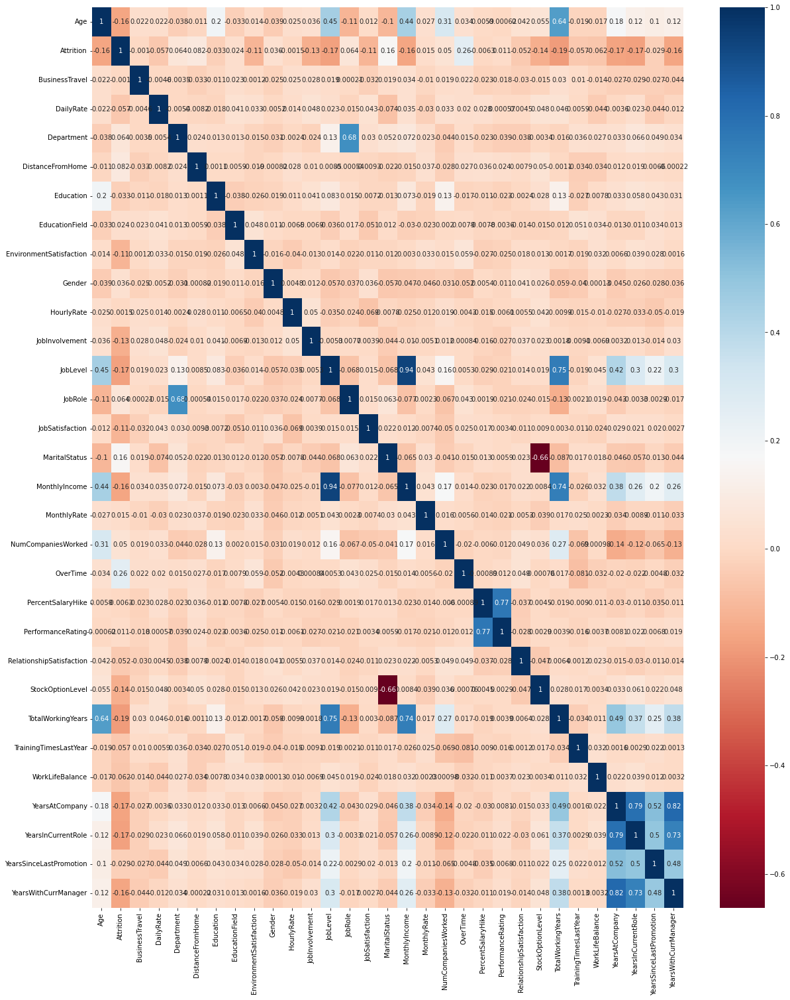

In [352]:
plt.figure(figsize=(20,25))
sns.heatmap(df.corr(),annot=True,cmap='RdBu')

- There is negative correlation between MaritalStatus and StockOptionLevel

### Plot for positively and negatively correlated data

<AxesSubplot:>

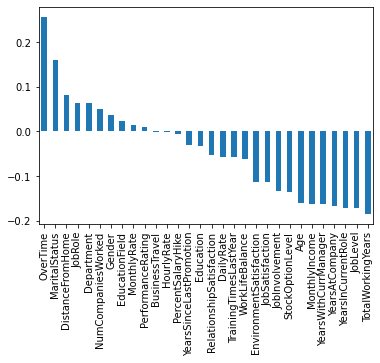

In [353]:
df.corr()['Attrition'].sort_values(ascending=False).drop(['Attrition']).plot(kind='bar')

- Overtime,martialstatus,distance from home, job role,department,num of companies worked,gender,education field,monthly rate,performance rating are the features which are positively correlated
- years since last promotion,education,relationship satisfaction,dailyrate,training times last year,work life balance,environment satisfaction,job satisfaction,job involvement,stock option level,age,monthly income,years with current manager,years at company,years in current role,joblevel,total working years has very negative correlation with the data

### Attrition Feature balance levels

In [354]:
df['Attrition'].value_counts()

0    1158
1     229
Name: Attrition, dtype: int64

([<matplotlib.patches.Wedge at 0x7f7bee330040>,
 [Text(-0.9553155748464781, 0.5453183954862914, ''),
  Text(0.9553155237900809, -0.5453184849293883, '')],
 [Text(-0.5210812226435334, 0.2974463975379771, '83.49%'),
  Text(0.5210811947945896, -0.29744644632512085, '16.51%')])

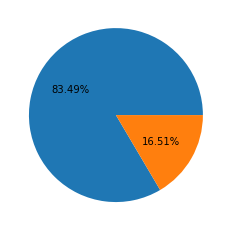

In [355]:
plt.pie(df['Attrition'].value_counts(),autopct='%1.2f%%')

- The data is very much imbalanced here

### Finding skewness in the dataset 

In [356]:
df.skew()

Age                         0.472280
Attrition                   1.805983
BusinessTravel             -1.426774
DailyRate                  -0.017078
Department                  0.183919
DistanceFromHome            0.954752
Education                  -0.289024
EducationField              0.544868
EnvironmentSatisfaction    -0.325285
Gender                     -0.417296
HourlyRate                 -0.030481
JobInvolvement             -0.501401
JobLevel                    1.126075
JobRole                    -0.386843
JobSatisfaction            -0.345612
MaritalStatus              -0.160952
MonthlyIncome               1.544770
MonthlyRate                 0.030596
NumCompaniesWorked          1.037715
OverTime                    0.954751
PercentSalaryHike           0.800592
PerformanceRating           1.931566
RelationshipSatisfaction   -0.295686
StockOptionLevel            0.962332
TotalWorkingYears           1.034487
TrainingTimesLastYear       0.577614
WorkLifeBalance            -0.557100
Y

- we have skewness in
    * DistanceFromHome
    * JobLevel
    * MonthlyIncome
    * NumCompaniesWorked
    * OverTime
    * PercentSalaryHike
    * StockOptionLevel
    * TotalWorkingYears
    * YearsAtCompany
    * YearsSinceLastPromotion
    * YearsInCurrentRole

### Plotting graph to see skewness visually

In [357]:
x.sample()

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1372,39,Travel_Rarely,867,Research & Development,9,2,Medical,1,Male,87,...,4,4,1,10,3,3,10,0,7,9


In [358]:
df.sample()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
366,40,0,2,759,2,2,2,2,4,0,...,3,3,2,8,5,3,5,4,1,3


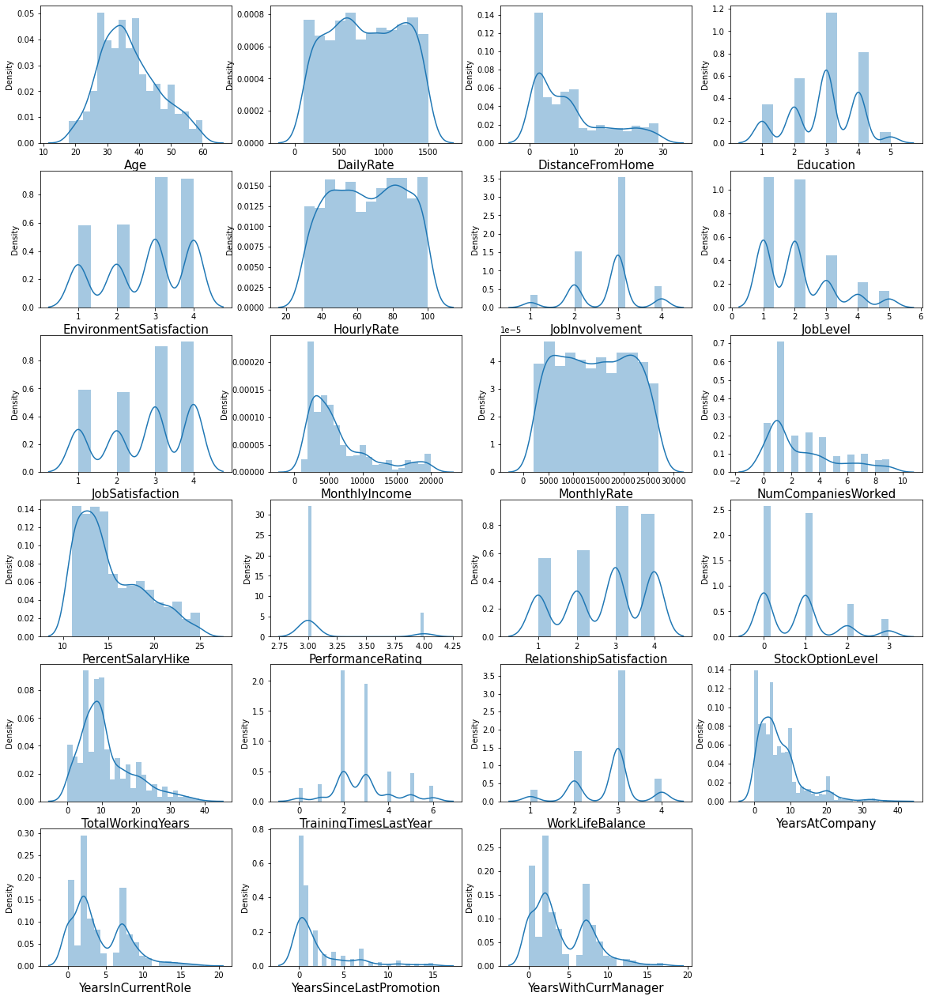

In [359]:
plt.figure(figsize=(20,30),facecolor='white')
plotnum=1
for col in x.drop(columns = ['BusinessTravel','Department','EducationField','Gender','JobRole','MaritalStatus','OverTime']):
    if plotnum<=30:
        plt.subplot(8,4,plotnum)
        sns.distplot(x[col])
        plt.xlabel(col,fontsize=15)
    plotnum+=1
plt.show()

- Age graph is little skewed towards left.
- DailyRate is little normalised in nature
- Distancefrom home is skewed towards left.
- Education has some skewness as the mean is 3 and mean is large amount in data,so the graph is showing high at 3
- Monthly income is left skewed
- number of companies worked is left skewed
- Percent salary hike,total working hours,years at company,years in current role,years since last promotion,years with curr manager has left skewness

In [360]:
### Removing skewness using sqrt method
orig_df = df.copy()
cols = ['DistanceFromHome','JobLevel','MonthlyIncome','NumCompaniesWorked','OverTime','PercentSalaryHike','StockOptionLevel','TotalWorkingYears','YearsAtCompany','YearsSinceLastPromotion','YearsInCurrentRole']
for col_name in cols:
    orig_df[col_name] = np.sqrt(orig_df[col_name])
orig_df.skew()

Age                         0.472280
Attrition                   1.805983
BusinessTravel             -1.426774
DailyRate                  -0.017078
Department                  0.183919
DistanceFromHome            0.394018
Education                  -0.289024
EducationField              0.544868
EnvironmentSatisfaction    -0.325285
Gender                     -0.417296
HourlyRate                 -0.030481
JobInvolvement             -0.501401
JobLevel                    0.649012
JobRole                    -0.386843
JobSatisfaction            -0.345612
MaritalStatus              -0.160952
MonthlyIncome               0.950248
MonthlyRate                 0.030596
NumCompaniesWorked          0.039150
OverTime                    0.954751
PercentSalaryHike           0.636544
PerformanceRating           1.931566
RelationshipSatisfaction   -0.295686
StockOptionLevel            0.063863
TotalWorkingYears           0.042345
TrainingTimesLastYear       0.577614
WorkLifeBalance            -0.557100
Y

- we have lot of data skewness has been removed using sqrt method

### Removing skewness using yeo-johnson method

In [361]:
from sklearn.preprocessing import PowerTransformer
power_transform = PowerTransformer(method = 'yeo-johnson', standardize=True)
nor_df = df[cols].copy()
transformed= power_transform.fit_transform(nor_df)
transformed = pd.DataFrame(transformed, columns=nor_df.columns)
transformed

,DistanceFromHome,JobLevel,MonthlyIncome,NumCompaniesWorked,OverTime,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,YearsAtCompany,YearsSinceLastPromotion,YearsInCurrentRole
0,-1.489968,0.349828,0.386674,1.620671,1.584737,-1.495549,-1.084263,-0.173231,0.231837,-1.073534,0.290524
1,0.244561,0.349828,0.144235,-0.561880,-0.631019,1.690425,0.548653,0.147620,0.948319,0.193168,1.006575
2,-1.028366,-1.141761,-1.431153,1.273711,1.584737,0.193797,-1.084263,-0.351153,-2.156089,-1.073534,-1.571814
3,-0.698191,-1.141761,-0.814425,-0.561880,1.584737,-1.495549,-1.084263,-0.173231,0.621429,1.027520,1.006575
4,-1.028366,-1.141761,-0.504453,1.764103,-0.631019,-0.957525,0.548653,-0.544046,-0.933983,0.722874,-0.390769
...,...,...,...,...,...,...,...,...,...,...,...
1382,1.408969,0.349828,-1.039557,0.798319,-0.631019,0.716255,0.548653,1.039364,0.003289,-1.073534,-0.390769
1383,-0.049519,1.133237,1.127335,0.798319,-0.631019,0.193797,0.548653,-0.007630,0.436162,0.193168,1.006575
1384,-0.440553,0.349828,0.424210,-0.561880,1.584737,1.285201,0.548653,-0.544046,0.231837,-1.073534,-0.390769
1385,-1.028366,0.349828,0.222228,0.052119,-0.631019,-0.129959,-1.084263,1.039364,0.791264,-1.073534,0.793764


#### Checking skewness again after performing yeo-johnson method

In [362]:
dup_df = df.copy()

In [363]:
transformed.index = dup_df.index
dup_df[cols] = transformed[cols]
df.skew()

Age                         0.472280
Attrition                   1.805983
BusinessTravel             -1.426774
DailyRate                  -0.017078
Department                  0.183919
DistanceFromHome            0.954752
Education                  -0.289024
EducationField              0.544868
EnvironmentSatisfaction    -0.325285
Gender                     -0.417296
HourlyRate                 -0.030481
JobInvolvement             -0.501401
JobLevel                    1.126075
JobRole                    -0.386843
JobSatisfaction            -0.345612
MaritalStatus              -0.160952
MonthlyIncome               1.544770
MonthlyRate                 0.030596
NumCompaniesWorked          1.037715
OverTime                    0.954751
PercentSalaryHike           0.800592
PerformanceRating           1.931566
RelationshipSatisfaction   -0.295686
StockOptionLevel            0.962332
TotalWorkingYears           1.034487
TrainingTimesLastYear       0.577614
WorkLifeBalance            -0.557100
Y

#### sqrt method is working great in this dataset

In [364]:
orig_df.sample()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
670,29,1,2,906,1,3.162278,3,1,4,0,...,4,3,0.0,1.732051,5,3,0.0,0.0,0.0,0


In [365]:
orig_df.shape

(1387, 31)

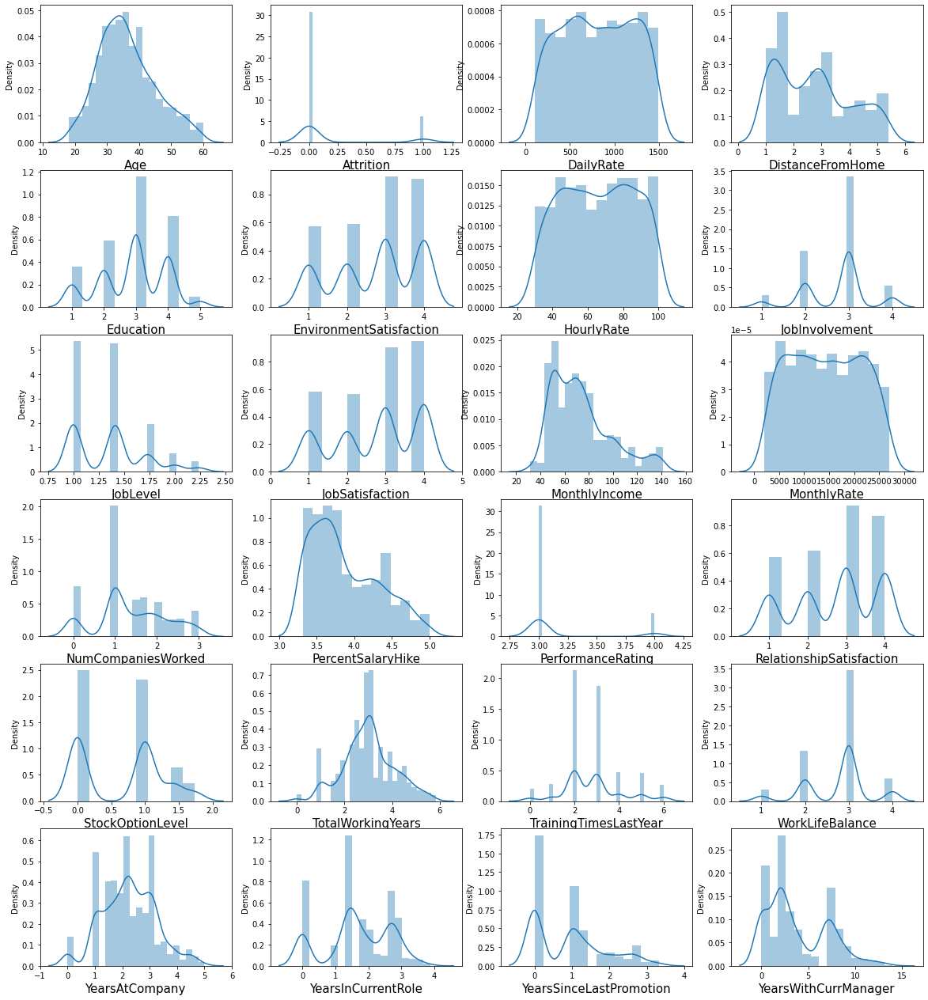

In [366]:
plt.figure(figsize=(20,30),facecolor='white')
plotnum=1
for col in orig_df.drop(columns = ['BusinessTravel','Department','EducationField','Gender','JobRole','MaritalStatus','OverTime']):
    if plotnum<=30:
        plt.subplot(8,4,plotnum)
        sns.distplot(orig_df[col])
        plt.xlabel(col,fontsize=15)
    plotnum+=1
plt.show()

- Data Looks little normalized now

### Standardization

In [367]:
# splitting the data
x = orig_df.drop('Attrition',axis=1)
y = orig_df['Attrition']

In [368]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split,GridSearchCV
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.2,random_state=3)

In [369]:
scalar = StandardScaler()
scalar.fit(x_train)
x_train_standardized = scalar.transform(x_train)
x_test_standardized = scalar.transform(x_test)

#### standard deviations for standardized data

In [370]:
print('The std for x_train_standardized is ', x_train_standardized.std())
print('The std for x_test_standardized is ', x_test_standardized.std())

The std for x_train_standardized is  1.0
The std for x_test_standardized is  1.00386743967487


### Checking Multicollinearity using VIF

In [371]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
def calc_VIF(scaled_x):
    #Calculating VIF
    vif = pd.DataFrame()
    vif['Features'] = x.columns
    vif['VIF'] = [variance_inflation_factor(scaled_x,i) for i in range(scaled_x.shape[1])]
    return vif

In [372]:
calc_VIF(x_train_standardized)

,Features,VIF
0,Age,1.900423
1,BusinessTravel,1.016696
2,DailyRate,1.032959
3,Department,2.099130
4,DistanceFromHome,1.031861
5,Education,1.081103
6,EducationField,1.021663
7,EnvironmentSatisfaction,1.033642
8,Gender,1.030215
9,HourlyRate,1.025979


### Finding Principle Component Analaysis

In [373]:
from sklearn.decomposition import PCA

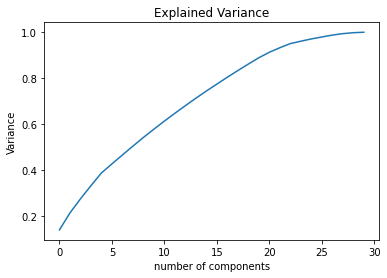

In [374]:
pca = PCA()
principlecomponents = pca.fit_transform(x_train_standardized)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('Variance')
plt.title('Explained Variance')
plt.show()

- 27-28  coponents explains around 95% variance in data

In [375]:
pca = PCA(n_components=28)
new_comp = pca.fit_transform(x_train_standardized)
principle_x = pd.DataFrame(new_comp,columns=np.arange(28))
principle_x

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,2.509028,-2.591786,-2.085467,0.769699,-0.079034,0.080773,-1.257521,2.534019,1.206370,-0.500890,...,-0.483944,-0.238835,1.640792,1.284491,1.027350,1.332659,0.327180,0.304784,-0.199043,0.809507
1,0.239533,1.684697,0.592015,-1.005494,0.467126,1.348001,-0.346469,2.218167,0.568951,-0.403614,...,-0.016031,0.630378,-0.206858,-0.049071,-1.155621,0.094266,-0.594914,0.206303,0.829600,-0.023655
2,3.185516,2.805093,-1.138068,-0.581601,1.550198,0.892634,1.316545,-0.630484,-0.043015,0.491455,...,-0.358614,1.581601,0.101414,-0.081775,0.514255,-1.136463,-0.754819,0.881238,0.337257,0.511891
3,-3.461438,0.338936,2.176745,1.263091,-0.716791,-0.320702,-1.367028,0.355268,0.990914,-0.367148,...,-0.039681,2.093379,-1.507429,0.109381,-0.082959,0.089159,0.745191,0.918071,0.050573,-0.391438
4,-1.656075,-0.934322,0.022160,-0.880008,0.018884,0.674071,0.340529,0.635602,1.305788,-1.759053,...,0.471152,0.373624,-0.304160,0.532060,-0.319907,-0.273182,0.554319,-0.219560,-0.206674,0.144551
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1104,-0.923689,-0.353638,0.432747,-0.274270,3.239141,-0.694999,1.604461,-1.452628,-0.233282,-0.115470,...,0.350014,0.297443,-1.217677,-0.132214,-0.218512,-0.317703,0.496739,-0.765270,0.309823,-0.405502
1105,-2.651285,-1.415467,-0.703785,0.286408,0.644691,-1.478133,-0.114036,0.717554,-1.389997,-0.306787,...,-0.414927,-0.864053,0.748323,0.167171,-0.592736,-0.542799,0.698668,-0.610412,0.429068,0.163055
1106,-1.344917,0.231322,-0.236843,-0.844007,-0.125119,-1.417823,1.818321,-1.829932,-0.937709,-0.373756,...,0.350263,-2.008363,0.301424,-0.637418,0.503507,-0.141408,0.646620,0.858552,0.274281,-0.229932
1107,0.204816,0.816931,-2.132302,1.486986,-0.943634,-0.469046,0.006008,-2.055206,-0.659383,0.900691,...,-1.627994,-0.675390,-0.346651,-0.902356,-0.301722,-0.673967,-0.348394,-0.500678,0.198900,0.696128


### k-best-features

In [376]:
from sklearn.feature_selection import SelectKBest, f_classif

In [377]:
k_best_features = SelectKBest(score_func=f_classif, k=30)
best_fit = k_best_features.fit(x,y)
dfscores = pd.DataFrame(best_fit.scores_)
dfcolumns = pd.DataFrame(x.columns)

In [378]:
featureScores = pd.concat([dfcolumns,dfscores],axis = 1)
featureScores.columns = ['Feature', 'Score']
print(featureScores.nlargest(22,'Score'))

                     Feature      Score
18                  OverTime  98.140453
23         TotalWorkingYears  69.732122
26            YearsAtCompany  56.150936
27        YearsInCurrentRole  52.245659
11                  JobLevel  48.546942
15             MonthlyIncome  46.706180
22          StockOptionLevel  44.097137
29      YearsWithCurrManager  37.468266
14             MaritalStatus  36.836958
0                        Age  36.092149
10            JobInvolvement  25.307350
13           JobSatisfaction  18.303387
7    EnvironmentSatisfaction  17.719366
4           DistanceFromHome   9.549910
12                   JobRole   5.747073
3                 Department   5.631654
25           WorkLifeBalance   5.429960
24     TrainingTimesLastYear   4.559904
2                  DailyRate   4.549637
17        NumCompaniesWorked   3.886525
21  RelationshipSatisfaction   3.805168
28   YearsSinceLastPromotion   2.917930


- Dropping the high collinear feature and less score feature

In [379]:
x_best_feature = x.drop(columns=['OverTime','YearsSinceLastPromotion'],axis=1)
x_best_feature.head()

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,HourlyRate,...,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsWithCurrManager
0,41,2,1102,2,1.000000,2,1,2,0,94,...,3.316625,3,1,0.0,2.828427,0,1,2.449490,2.000000,5
1,49,1,279,1,2.828427,1,1,3,1,61,...,4.795832,4,4,1.0,3.162278,3,3,3.162278,2.645751,7
2,37,2,1373,1,1.414214,2,4,4,1,92,...,3.872983,3,2,0.0,2.645751,3,3,0.000000,0.000000,0
3,33,1,1392,1,1.732051,4,1,4,0,56,...,3.316625,3,3,0.0,2.828427,3,3,2.828427,2.645751,0
4,27,2,591,1,1.414214,1,3,1,1,40,...,3.464102,3,4,1.0,2.449490,3,3,1.414214,1.414214,2


In [380]:
### removed column from the data by getting it based of best features
best_feat_df = scalar.fit_transform(x_best_feature)

In [381]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score,r2_score,mean_squared_error
from xgboost import XGBClassifier
models = [LogisticRegression(),SVC(),GaussianNB(),DecisionTreeClassifier(),RandomForestClassifier(),XGBClassifier(),KNeighborsClassifier(),GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0),AdaBoostClassifier(n_estimators=100, random_state=0)]

In [382]:
x_train,x_test,y_train,y_test = train_test_split(best_feat_df,y,test_size=.31,stratify=y,random_state=5)

def compare_models():
    for model in models:
        
        model.fit(x_train,y_train)
        model_predict = model.predict(x_test)
        score_r2 = r2_score(y_test, model_predict)
        mean_error = mean_squared_error(y_test, model_predict)
        crossval_score = cross_val_score(model,best_feat_df,y,cv=4).mean()
        print("R2 score of the model : ",model,"=",round(score_r2*100,1),"%")
        print("mean squared error for model : ",model,"=",mean_error)
        print("cross val score for model : ",model, "=",crossval_score)
        print('_______________________________________________')
compare_models()

R2 score of the model :  LogisticRegression() = -4.6 %
mean squared error for model :  LogisticRegression() = 0.14418604651162792
cross val score for model :  LogisticRegression() = 0.8522013626293081
_______________________________________________
R2 score of the model :  SVC() = -16.4 %
mean squared error for model :  SVC() = 0.16046511627906976
cross val score for model :  SVC() = 0.8464314270960004
_______________________________________________
R2 score of the model :  GaussianNB() = -55.2 %
mean squared error for model :  GaussianNB() = 0.21395348837209302
cross val score for model :  GaussianNB() = 0.785871049957522
_______________________________________________
R2 score of the model :  DecisionTreeClassifier() = -72.1 %
mean squared error for model :  DecisionTreeClassifier() = 0.2372093023255814
cross val score for model :  DecisionTreeClassifier() = 0.7512556012726758
_______________________________________________
R2 score of the model :  RandomForestClassifier() = -14.7 %


### Getting the best random score

In [383]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score,confusion_matrix, roc_curve, roc_auc_score
maxAcc = 0
maxRS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(best_feat_df,y,test_size = .31, random_state = i,stratify = y)
    modRF =  LogisticRegression()
    modRF.fit(x_train,y_train)
    pred = modRF.predict(x_test)
    acc  = accuracy_score(y_test,pred)
    if acc>maxAcc:
        maxAcc=acc
        maxRS=i
print(f"Best Accuracy is: {maxAcc} on random_state: {maxRS}")

Best Accuracy is: 0.8790697674418605 on random_state: 96


In [384]:
x_train,x_test,y_train,y_test = train_test_split(best_feat_df,y,test_size=0.2,random_state=96)
compare_models()

R2 score of the model :  LogisticRegression() = -6.4 %
mean squared error for model :  LogisticRegression() = 0.1618705035971223
cross val score for model :  LogisticRegression() = 0.8522013626293081
_______________________________________________
R2 score of the model :  SVC() = -15.9 %
mean squared error for model :  SVC() = 0.17625899280575538
cross val score for model :  SVC() = 0.8464314270960004
_______________________________________________
R2 score of the model :  GaussianNB() = -63.2 %
mean squared error for model :  GaussianNB() = 0.24820143884892087
cross val score for model :  GaussianNB() = 0.785871049957522
_______________________________________________
R2 score of the model :  DecisionTreeClassifier() = -60.9 %
mean squared error for model :  DecisionTreeClassifier() = 0.2446043165467626
cross val score for model :  DecisionTreeClassifier() = 0.7447881094767703
_______________________________________________
R2 score of the model :  RandomForestClassifier() = -20.6 %
m

[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=l2, random_state=20, solver=l

[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=none, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=none, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=none, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=500, multi_clas

R2 score of the model :  AdaBoostClassifier(n_estimators=100, random_state=0) = -15.9 %
mean squared error for model :  AdaBoostClassifier(n_estimators=100, random_state=0) = 0.17625899280575538
cross val score for model :  AdaBoostClassifier(n_estimators=100, random_state=0) = 0.8428332861354967
_______________________________________________


### Hyper Parameter Tuning

In [385]:
logistic_params = {'penalty' : ['l1', 'l2', 'elasticnet', 'none'],
    'C' : np.logspace(-4, 4, 20),
    'solver' : ['lbfgs','newton-cg','liblinear','sag','saga'],
    'max_iter' : [100, 1000,2500, 5000]
    }
grid_classifier = GridSearchCV(LogisticRegression(),logistic_params,cv=5,n_jobs=-1,verbose=1)
grid_classifier.fit(x_train,y_train)
print(f"The best parameters are {grid_classifier.best_params_}")
print(f"The best Score is {grid_classifier.best_score_}")

Fitting 5 folds for each of 1600 candidates, totalling 8000 fits
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_

[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=none, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=none, random_state=5, s

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_v

    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_mo

ValueError: Solver sag supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got so

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_vali/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit fail/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
ed. Th

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selecti/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
on/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/skle

    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
tition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-pa/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3

    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selec/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/pyth

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)


  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1314, in fit
    raise ValueError("l1_ratio must be between 0 and 1;"
ValueError: l1_ratio must be between 0 and 1; got (l1_ratio=None)

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1314, in fit
    r

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1314, in fit
    raise ValueError("l1_ratio must be between 0 and 1;"
ValueError: l1_ratio must be between 0 and 1; got (l1_ratio=None)

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_sol

    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1314, in fit
    raise ValueError("l1_ratio must be between 0 and 1;"
ValueError: l1_ratio must be between 0 and 1; got (l1_ratio=None)

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1314, in fit
    raise ValueError("l1_ratio must be between 0 and 1;"
ValueError: l1_ratio must be between 0 and 1; got (l1_ratio=None)

  warnings.warn("Estimator fit failed. The score on

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueErro

    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties,

    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_para

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_val/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
idation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/mode

/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/s

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_val

Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/pyt

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/s

ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/mode

/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/s

/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/o

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-te

    raise ValueError("l1_ratio must be between 0 and 1;"
ValueError: l1_ratio must be between 0 and 1; got (l1_ratio=None)

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supp

    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_val

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, 

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-package

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklear

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_val

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this 

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver newton-cg supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklear

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"


  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_mod

/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimat

    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1314, in fit
    raise ValueError("l1_ratio must be between 0 and 1;"
ValueE

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_val

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_mod

    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties,

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1314, in fit
    raise ValueError("l1_ratio must be between 0 and 1;"
ValueError: l1_ratio must be between 0 and 1; got (l1_ratio=None)

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/p

/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1322: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver sag supports only 'l2' 

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_v

The best parameters are {'C': 0.08858667904100823, 'max_iter': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
The best Score is 0.8620439443968856


/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 443, in _check_solver
    raise ValueError("Solver %s supports only 'l2' or 'none' penalties, "
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got elasticnet penalty.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_sele

- The best parameters are {'C': 0.08858667904100823, 'max_iter': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
- The best Score is 0.8620439443968856

### ROC AUC Score for all models

In [386]:
for mod in models:
    mod_pred = mod.predict(x_test)
    print('ROC AUC SCORE FOR MODEL : ',mod," is : ",roc_auc_score(y_test, mod_pred))
    print('Confusion matrix is',confusion_matrix(y_test, mod_pred))

ROC AUC SCORE FOR MODEL :  LogisticRegression()  is :  0.6043226684819606
Confusion matrix is [[221   5]
 [ 40  12]]
ROC AUC SCORE FOR MODEL :  SVC()  is :  0.5436521443158612
Confusion matrix is [[224   2]
 [ 47   5]]
ROC AUC SCORE FOR MODEL :  GaussianNB()  is :  0.640061266167461
Confusion matrix is [[185  41]
 [ 28  24]]
ROC AUC SCORE FOR MODEL :  DecisionTreeClassifier()  is :  0.5904526889040163
Confusion matrix is [[193  33]
 [ 35  17]]
ROC AUC SCORE FOR MODEL :  RandomForestClassifier()  is :  0.5392273655547992
Confusion matrix is [[222   4]
 [ 47   5]]
ROC AUC SCORE FOR MODEL :  XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.300000012, max_bin=256, ma

### ROC AUC Curves for all models

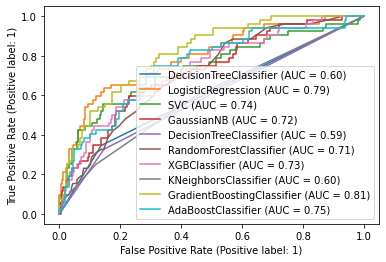

In [387]:
from sklearn.metrics import plot_roc_curve
disp = plot_roc_curve(DecisionTreeClassifier().fit(x_train,y_train),x_test,y_test)
for i in models:
    plot_roc_curve(i,x_test,y_test, ax=disp.ax_)
plt.legend(prop={'size':10}, loc = 'lower right')
plt.show()

In [388]:
parameter = {'C':[0.001,0.01,0.1,0,1,1.1],'penalty':['l1', 'l2', 'elasticnet', 'none'],'dual': [True,False],'fit_intercept':[True,False],'random_state':[1,2,3,5,10,20,45],'solver':['liblinear'],'max_iter':[100,200,300,400,500],'multi_class':['auto', 'ovr', 'multinomial']}

In [389]:
GridCV = GridSearchCV(LogisticRegression(),parameter,cv=5,n_jobs = -1,verbose=2)

In [390]:
GridCV.fit(x_train,y_train)

Fitting 5 folds for each of 10080 candidates, totalling 50400 fits


/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of 

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The sc

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
s/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for thes/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)


  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarni/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/pytho

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_select

    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most rdel/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported s

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarni

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packag

ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError(

    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_mode

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
. The score on this train-test partition for these parameters will be s

    solver_type = _get_liblinear_solver_type(multi_IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

et penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 130

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in 

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_

[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l1, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=none, random_state=1, solver

/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _f

[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=auto, penalty=l2, random_state=3, solver=l

 score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: E

[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=400, multi_

i_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_sele/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, mu

 line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anac

[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=none, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=none, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=none, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=none, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=none, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=True, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=none, random_state=10, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dua


  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-pa/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=none, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=none, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, m

hon3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in 

    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warning

[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.001, dual=False, fit_intercept=False,

tic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Es/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

tercept=True, max_iter=200, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=none, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=True, max_iter=200, multi_class=m

re
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-pack/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in 

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_mode/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anac

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on thpython3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solv

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=none, random_state=2, solver

ation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for thes

  File "/opt/anaconda3/lib/python3.9/site-paIOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=True, fit_intercept=False, max_iter=500, multi_class=multino

r_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
ython3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_mo

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598,

[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=100, multi_class=auto, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=100, multi_class=auto, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=100, multi_class=auto, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l2, random_state=1, so

.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solve/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_mul

[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l1, random_state=45, s

ltinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/s

[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=100, multi_class=auto, penalty=none, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=100, multi_class=auto, penalty=none, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=200, multi_class=multinom

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self

[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.01, dual=False, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_sta

ogistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/pytho

ValueError: Only 'saga' solver suIOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
e 1306, in fit
    solver = _check_solver(self.solver, self.penalty, se/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning

[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=none, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=ovr, penalty=no

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solv

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueE

[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, p

on/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l1, random_state=2, solver

d. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be 

 fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time

 fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/pyth

r; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=True, fit_intercept=False, max_iter=300, multi_class=auto, penalty=

ages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
n. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solv

ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _

[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, pe

ython3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 59

    solvIOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_

[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=none, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=none, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=none, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=none, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=none, random_state=2, solver=l

1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=200, multi_class=mu

idation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 975, in _fit_liblinear
    raw_coef_, n_iter_ = liblinear.train_wrap(
  File "sklearn/svm/_liblinear.pyx", line 52, in sklearn.svm._liblinear.train_wrap
ValueError: b'C <= 0'

  warnings.warn("Estimator/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=none, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0.1, dual=False, fit_int

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

er = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 9

[CV] END C=0, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s

t failed. The score on this train-test"
/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 975, in _fit_liblinear
    raw_coef_, n_iter_ = liblinear.train_wrap(
  File "sklearn/svm/_liblinear.pyx", line 52, in sklearn.svm._liblinear.train_wrap
ValueError: b'C <= 0'

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarn

ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 975, in _fit_liblinear
    raw_coef_, n_iter_ = liblinear.train_wrap(
  File "sklearn/svm/_liblinear.pyx", line 52, in sklearn.svm._liblinear.train_wrap
ValueError: b'C <= 0'

  warnings.warn("Est

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_seIOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=auto, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=ovr, penalty=l1, random_state=1, solver=liblinear; total time=  

near
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-package

    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of 

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(s

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Det

ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=

[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l1, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l1, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l1, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l1, ran

r these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent

[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=l

('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, 

t=False, max_iter=400, multi_class=multinomial, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=400, multi_class=multinomial, penalty=l2, random_state=45, solver=libl

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/op

[CV] END C=0, dual=False, fit_intercept=True, max_iter=300, multi_class=multinomial, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=auto, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=auto, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=500, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time

opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueE

total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, penalty=l2, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=200, multi_class=multinomial, pen

estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", 

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The sc

[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=l1, random_state=3, solver=liblinear; total time=

ver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site

i_class=ovr, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=l1, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=500, multi_class=ovr, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=5

_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self

[CV] END C=0, dual=False, fit_intercept=True, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=True, max_iter=400, multi_class=auto, penalty=el

anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:985: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn("Liblinear failed to converge, increase "
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (mo

[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=0, dual=False, fit_intercept=False, max_iter=200, multi_class=auto, pen

/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Trace

    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueErr/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  F

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
ecent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: 

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("E

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'sa/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt

[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l2, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l2, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l2, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[C

-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The sco

tal time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=100, multi_class=ovr, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=100, multi_class=ovr, penalty=none, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l1, ran

Error: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=libli

[CV] END C=1, dual=True, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; tota

"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    

ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

 

    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.w

[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=300, multi_class=ovr, penalty=elasticnet, random_sta

it_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _che

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/sit

[CV] END C=1, dual=True, fit_intercept=False, max_iter=100, multi_class=multinomial, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=200, multi_class=ovr, penalty=elasti

it(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9

END C=1, dual=True, fit_intercept=True, max_iter=500, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=500, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=500, multi_class=auto, penalty=none, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=500, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=500, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=500, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=True, max_iter=500, multi_class=auto, penalty=none, random_state=3, solver=liblinear; total time=   0.

hon3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
ore on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

[CV] END C=1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=l2, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=l2, ran

warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The sc

    estimator.fit(X_traIOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[CV] END C=1, dual=False, fit_intercept=True, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solv

  warnings.warn("Liblinear failed to converge, increase "
nalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimat

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_select

[CV] END C=1, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=500, multi_class=multinomial, penalty=elasticnet, random_state=5, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_it

packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
ition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fi

    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/o

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
es/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", lin

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/li

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (m/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/sit

[CV] END C=1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=none, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=500, multi_class=auto, penalty=none, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=500, multi_class=multinomial, penalty=l2, rand

 Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, /opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(s

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarni

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
y, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to na

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/sit

[CV] END C=1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=True, max_iter=400, multi_class=ovr, penalty=elasticnet, ran

, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1358, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/opt/anaconda3/lib/python3.9/site-packages

lse, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=200, multi_class=multinomial, penalty=l1, random_state=2, s

t/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 974, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty, loss, dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py", line 830, in _get_liblinear_solver_type
    raise ValueError('Unsupported set of arguments: %s, '
ValueError: Unsupported set of arguments: The combination of penalty='l1' and loss='logistic_regression' are not supported when dual=True, Parameters: penalty='l1', loss='logistic_regression', dual=True

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The sc

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_select

[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=elasticnet, random_state=3, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=elasticn

e "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_log

nomial, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=400, multi_class=multinomial, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=500, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=500, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=500, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=500, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=500, multi_class=ovr, penalty=elasticnet, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, d

/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise Va

[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; total time=

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
el_selection/_validation.py", line 598, in _fit_and_score
    estimatorfit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty

near; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=300, multi_class=auto, penalty=l1, random_state=4

ost recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_

[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l2, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l2, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l2, random_state=1, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=l2, random_state=2, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=True, max_iter=100, multi_class=multinomial, penalty=

i_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
el_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/py

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_val

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
s/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-p

[CV] END C=1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1, dual=False, fit_intercept=False, max_iter=400, multi_class=auto, pen

ueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=lib

0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=l2, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=400, multi_class=ovr, penalty=elasticnet, random_state=1, solver=libli

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The sc/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
ore on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9

    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.p

    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
ore on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/s

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 450, in _check_solver
    raise ValueError("Only 'saga' solver supports elasticnet penalty,"
ValueError: Only 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_select

/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The sc

[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=500, multi_class=auto, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=500, multi_class=au

packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
ver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/o

[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=multinomial, penalty=elasticnet, random_state=45, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_int

.dual)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 454, in _check_solver
    raise ValueError(
ValueError: penalty='none' is not supported for the liblinear solver

  warnings.warn("Estimator fit failed. The score on this train-test"
naconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, /opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-

[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=10, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; total time=   0.0s
[CV] END C=1.1, dual=True, fit_intercept=False, max_iter=300, multi_class=ovr, penalty=l2, random_state=20, solver=liblinear; tota

packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1306, in fit
    solver = _check_solver(self.solver

  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 1350, in fit
    multi_class = _check_multi_class(self.multi_class, solver,
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py", line 473, in _check_multi_class
    raise ValueError("Solver %s does not support "
ValueError: Solver liblinear does not support a multinomial backend.

  warnings.warn("Estimator fit failed. The score on this train-test"
nly 'saga' solver supports elasticnet penalty, got solver=liblinear.

  warnings.warn("Estimator fit /opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)


GridSearchCV(cv=5, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [0.001, 0.01, 0.1, 0, 1, 1.1],
                         'dual': [True, False], 'fit_intercept': [True, False],
                         'max_iter': [100, 200, 300, 400, 500],
                         'multi_class': ['auto', 'ovr', 'multinomial'],
                         'penalty': ['l1', 'l2', 'elasticnet', 'none'],
                         'random_state': [1, 2, 3, 5, 10, 20, 45],
                         'solver': ['liblinear']},
             verbose=2)

In [391]:
GridCV.best_params_

{'C': 1,
 'dual': False,
 'fit_intercept': True,
 'max_iter': 100,
 'multi_class': 'auto',
 'penalty': 'l1',
 'random_state': 1,
 'solver': 'liblinear'}

In [392]:
Best_mod1 = LogisticRegression(C = 1,dual = False,fit_intercept = True,max_iter = 100,multi_class = 'auto', penalty = 'l1',random_state= 1,solver = 'liblinear')
Best_mod1.fit(x_train,y_train)
lrpred = Best_mod1.predict(x_test)
acc = accuracy_score(y_test,lrpred)
print(acc*100)

83.81294964028777


#### Saving the model

In [393]:
import joblib
joblib.dump(best_model,"HR_Attrition_model.pkl")

['HR_Attrition_model.pkl']

#### Loading the model

In [394]:
mod = joblib.load("HR_Attrition_model.pkl")
print(mod.predict(x_test))

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
